In [1]:
!pip install deepface opencv-python numpy pandas tensorflow keras
!pip install --upgrade tensorflow keras


In [12]:
import os
import numpy as np
import pandas as pd
import cv2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from deepface import DeepFace
import matplotlib.pyplot as plt


In [3]:
dataset_path = "faces_dataset/"

In [4]:
if not os.path.exists(dataset_path):
    os.makedirs(dataset_path)
    print(f"Created dataset directory: {dataset_path}")
people = ["Mitish", "Rishi", "Unknown person"]
for person in people:
    person_folder = os.path.join(dataset_path, person)
    if not os.path.exists(person_folder):
        os.makedirs(person_folder)
        print(f"Created folder for {person}")

In [5]:
# Define file for saving embeddings
embeddings_file = "face_embeddings.csv"

# Initialize list to store embeddings
face_data = []

In [6]:
datagen = ImageDataGenerator(
    rotation_range=10,      # Reduce rotation
    width_shift_range=0.1,  # Reduce horizontal shift
    height_shift_range=0.1, # Reduce vertical shift
    shear_range=0.1,        # Reduce shearing
    zoom_range=0.1,         # Reduce zoom
    horizontal_flip=True,   # Keep
    fill_mode="nearest"     # Keep
)

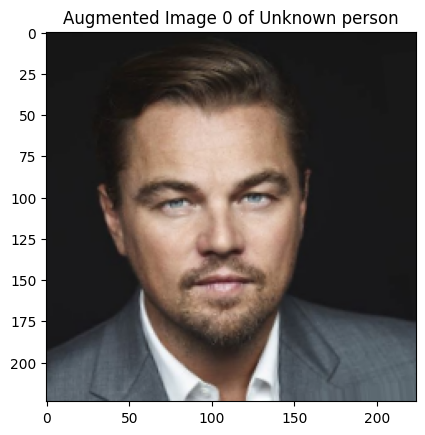

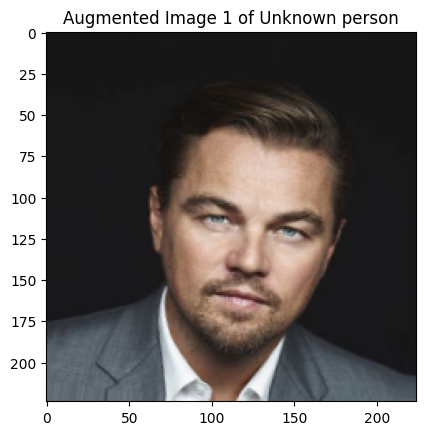

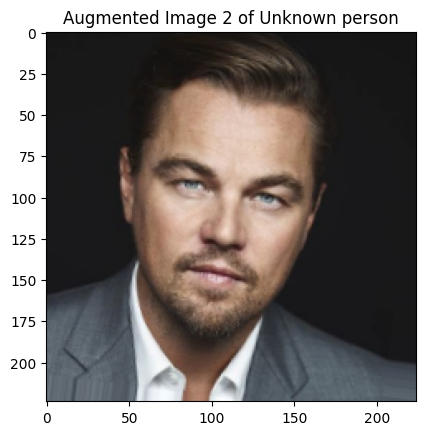

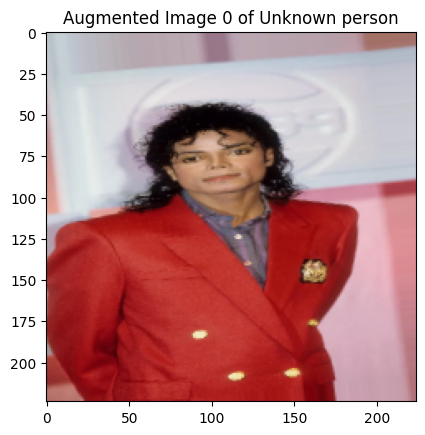

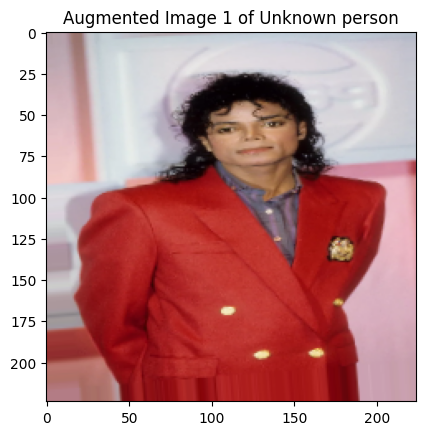

...

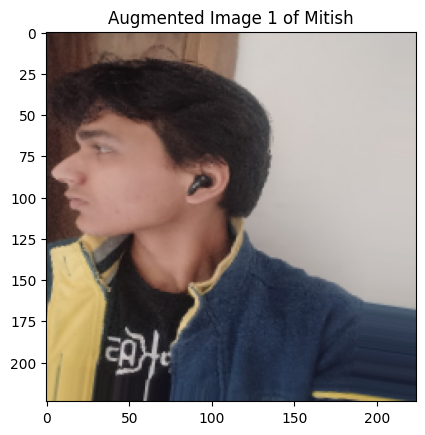

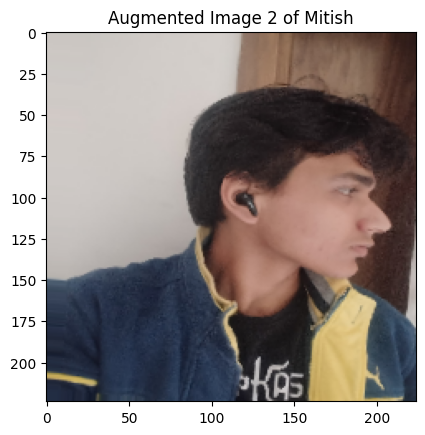

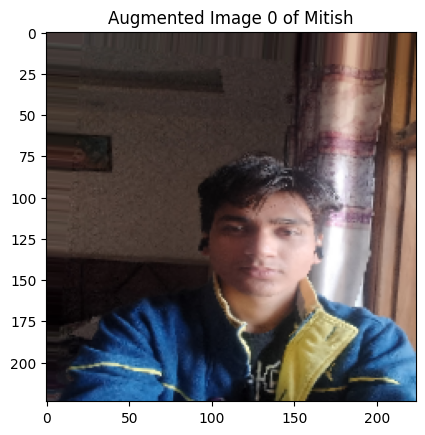

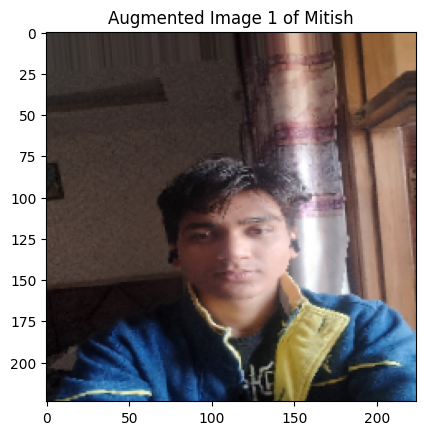

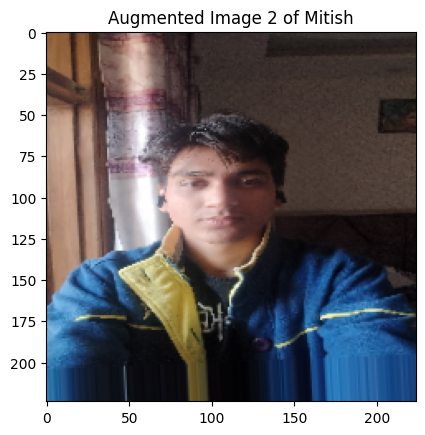

Face embeddings with augmentation saved successfully!


In [13]:
# Loop through each person's folder
for person in os.listdir(dataset_path):
    person_folder = os.path.join(dataset_path, person)

    if os.path.isdir(person_folder):
        for image_name in os.listdir(person_folder):
            image_path = os.path.join(person_folder, image_name)

            try:
                # Load the image
                img = cv2.imread(image_path)
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, (224, 224))

                # Convert image to numpy array and expand dims
                img_array = np.expand_dims(img, axis=0)

                # Apply augmentation (generate multiple variations)
                aug_iter = datagen.flow(img_array, batch_size=1)
                aug_images = [next(aug_iter)[0].astype(np.uint8) for _ in range(3)]

                # **📌 Display augmented images BEFORE passing to DeepFace**
                for i, aug_img in enumerate(aug_images):
                    plt.imshow(aug_img)
                    plt.title(f"Augmented Image {i} of {person}")
                    plt.show()

                # Save augmented images and pass file paths to DeepFace
                temp_paths = []
                for i, aug_img in enumerate([img] + aug_images):
                    temp_path = f"temp_aug_{person}_{i}.jpg"
                    cv2.imwrite(temp_path, cv2.cvtColor(aug_img, cv2.COLOR_RGB2BGR))
                    temp_paths.append(temp_path)

                # Extract embeddings from saved images
                for temp_path in temp_paths:
                    embedding = DeepFace.represent(img_path=temp_path, model_name="Facenet", enforce_detection=False)[0]['embedding']
                    face_data.append([person, embedding])
                    os.remove(temp_path)  # Delete temp file after processing

            except Exception as e:
                print(f"Error processing {image_path}: {e}")

# Convert to DataFrame & Save
df = pd.DataFrame(face_data, columns=["Person", "Embedding"])
df.to_csv(embeddings_file, index=False)
print("Face embeddings with augmentation saved successfully!")

In [14]:
import pandas as pd
import numpy as np
import pickle
from sklearn.svm import SVC
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score


In [15]:
embeddings_file = "/content/face_embeddings.csv"  # Update path if needed
df = pd.read_csv(embeddings_file)

In [16]:
# Convert string embeddings back to NumPy arrays
df["Embedding"] = df["Embedding"].apply(lambda x: np.array(eval(x)))

# Extract labels (Person Names) and embeddings (128D vectors)
X = np.array(df["Embedding"].tolist())  # Features (128D embeddings)
y = np.array(df["Person"].tolist())  # Labels (Person Names)

# Convert text labels to numbers
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)

# Train SVM classifier
clf = SVC(kernel='rbf', probability=True)
clf.fit(X_train, y_train)

# accuracy test
y_pred = clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(f"Classifier Accuracy: {accuracy:.2f}")

# Saving trained classifiers
with open("face_classifier.pkl", "wb") as f:
    pickle.dump(clf, f)

with open("label_encoder.pkl", "wb") as f:
    pickle.dump(label_encoder, f)

print("SVM Classifier Trained & Saved!")

Classifier Accuracy: 0.96
SVM Classifier Trained & Saved!


In [17]:
print("Train Set Size:", len(X_train))
print("Test Set Size:", len(X_test))

print(label_encoder.classes_)  # Show class names assigned to numeric labels


Train Set Size: 323
Test Set Size: 81
['Mitish' 'Rishi' 'Unknown person']


In [18]:
from google.colab import files

files.download("face_classifier.pkl")  # SVM model
files.download("label_encoder.pkl")  # Label encoder


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>